# <center>Лабораторная работа №1<center>


## Задание к лабораторной работе

1. Найдите в одном из открытых источников и выберите набор данных для решения задачи кластеризации
2. Проведите первичный анализ данных
3. В случае необходимости проведите удаление или заполнение пропусков и кодирование категориальных признаков
4. Определите оптимальное число кластеров
5. Обучите KMeans модель с оптимальным количеством кластеров
6. Визуализируйте результат кластеризации
7. Подготовьте отчет в формате .ipynb

## 1 Загрузка данных и библиотек

Используемый датасет представляет из себя набор из нескольких тысяч записей о различных видах бобов. В каждом столбце представлена информация о структуре, типе боба и т.д. Датасет также может быть использован для обучения модели мультиклассовой классификации.

[Ссылка](https://www.kaggle.com/datasets/sansuthi/dry-bean-dataset/data) на используемый датасет.

### 1.1 Описание данных

`Area` (A): Площадь зоны боба и количество пикселей в пределах его границ.\
`Perimeter` (P): Окружность боба определяется как длина его границы.\
`Major axis length` (L): Расстояние между концами самой длинной линии, которую можно провести через боб.\
`Minor axis length` (l): Самая длинная линия, которую можно провести через боб, стоя перпендикулярно главной оси.\
`Aspect ratio` (K): Определяет соотношение между L и l.\
`Eccentricity` (Ec): Эксцентриситет эллипса, имеющего такие же моменты, как и область боба.\
`Convex area` (C): Количество пикселей в наименьшем выпуклом многоугольнике, который может содержать площадь семени боба.\
`Equivalent diameter` (Ed): Диаметр круга, имеющего такую же площадь, как и площадь семени боба.\
`Extent` (Ex): Соотношение пикселей в ограничивающем прямоугольнике к площади боба.\
`Solidity` (S): Также известна как выпуклость. Соотношение пикселей в выпуклой оболочке к тем, что находятся в бобах.\
`Roundness` (R): Округлость\
`Compactness` (CO): Измеряет круглость объекта.\
`ShapeFactor1` (SF1)\
`ShapeFactor2` (SF2)\
`ShapeFactor3` (SF3)\
`ShapeFactor4` (SF4)\
`Class`: Seker, Barbunya, Bombay, Cali, Dermosan, Horoz и Sira.

### 1.2 Загрузка необходимых библиотек

In [50]:
import pandas as pd
import ydata as yd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import numpy as np
import math
import phik

import warnings

from ydata_profiling import ProfileReport

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import silhouette_score

from sklearn.pipeline import Pipeline
from imblearn.pipeline import Pipeline as ImbPipeline

from sklearn.ensemble import VotingClassifier

from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, LabelEncoder
from sklearn.preprocessing import FunctionTransformer

from sklearn.compose import ColumnTransformer

from sklearn.impute import SimpleImputer

from sklearn.decomposition import PCA

from itertools import combinations

pd.set_option('display.max_columns', None)
pd.set_option('display.float_format', '{:0.3f}'.format)

warnings.filterwarnings("ignore")

RANDOM_STATE = 42
TEST_SIZE = 0.25

### 1.3 Загрузка файлов и сохранение в датафреймы

In [51]:
data_beans = pd.read_csv('Dry_Bean.csv')

Приведем названия всех столбцов к snake_case:

In [52]:
data_beans.columns = data_beans.columns.str.replace('([a-z])([A-Z])', r'\1_\2', regex=True).str.lower()

#### 1.3.1 Проверка корректности  

In [53]:
print(data_beans.shape)
data_beans.sample()

(13611, 17)


,area,perimeter,major_axis_length,minor_axis_length,aspect_ration,eccentricity,convex_area,equiv_diameter,extent,solidity,roundness,compactness,shape_factor1,shape_factor2,shape_factor3,shape_factor4,class
10946,28533,626.862,235.335,154.765,1.521,0.753,28885,190.603,0.784,0.988,0.912,0.810,0.008,0.002,0.656,0.997,DERMASON


## 2 Первичный анализ данных

In [54]:
data_beans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13611 entries, 0 to 13610
Data columns (total 17 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   area               13611 non-null  int64  
 1   perimeter          13611 non-null  float64
 2   major_axis_length  13611 non-null  float64
 3   minor_axis_length  13611 non-null  float64
 4   aspect_ration      13611 non-null  float64
 5   eccentricity       13611 non-null  float64
 6   convex_area        13611 non-null  int64  
 7   equiv_diameter     13611 non-null  float64
 8   extent             13611 non-null  float64
 9   solidity           13611 non-null  float64
 10  roundness          13611 non-null  float64
 11  compactness        13611 non-null  float64
 12  shape_factor1      13611 non-null  float64
 13  shape_factor2      13611 non-null  float64
 14  shape_factor3      13611 non-null  float64
 15  shape_factor4      13611 non-null  float64
 16  class              136

Данные загрузились корректно, никакие наблюдения не потерялись. Типы данных соотвествуют исходным.

## 3 Исследовательский анализ данных + Корреляционный анализ данных

В данном исследовании я использовал библиотеку ydata для того, чтобы провести исследовательский анализ данных. 

In [55]:
profile = ProfileReport(data_beans, title="Beans Dataset Profiling Report", explorative=True)

profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## 4 Подготовка данных

Взглянем на данные еще раз:

In [56]:
data_beans.head()

,area,perimeter,major_axis_length,minor_axis_length,aspect_ration,eccentricity,convex_area,equiv_diameter,extent,solidity,roundness,compactness,shape_factor1,shape_factor2,shape_factor3,shape_factor4,class
0,28395,610.291,208.178,173.889,1.197,0.550,28715,190.141,0.764,0.989,0.958,0.913,0.007,0.003,0.834,0.999,SEKER
1,28734,638.018,200.525,182.734,1.097,0.412,29172,191.273,0.784,0.985,0.887,0.954,0.007,0.004,0.910,0.998,SEKER
2,29380,624.110,212.826,175.931,1.210,0.563,29690,193.411,0.778,0.990,0.948,0.909,0.007,0.003,0.826,0.999,SEKER
3,30008,645.884,210.558,182.517,1.154,0.499,30724,195.467,0.783,0.977,0.904,0.928,0.007,0.003,0.862,0.994,SEKER
4,30140,620.134,201.848,190.279,1.061,0.334,30417,195.897,0.773,0.991,0.985,0.971,0.007,0.004,0.942,0.999,SEKER


Разделим данные по их типу и проведем подготовку для передачи модели МО:

In [57]:
ohe_columns = ['class']

num_columns = data_beans.select_dtypes(include=['float', 'int']).columns

In [58]:
X_encoded = pd.get_dummies(data_beans, columns=ohe_columns, drop_first=True, dtype=int)

In [59]:
scaler = StandardScaler()

X_scaled = scaler.fit_transform(X_encoded)
X_scaled.shape

(13611, 22)

Перед обучением модели найдем наиболее подходящее число кластеров при помощи метода локтя:

## 5 Обучение 

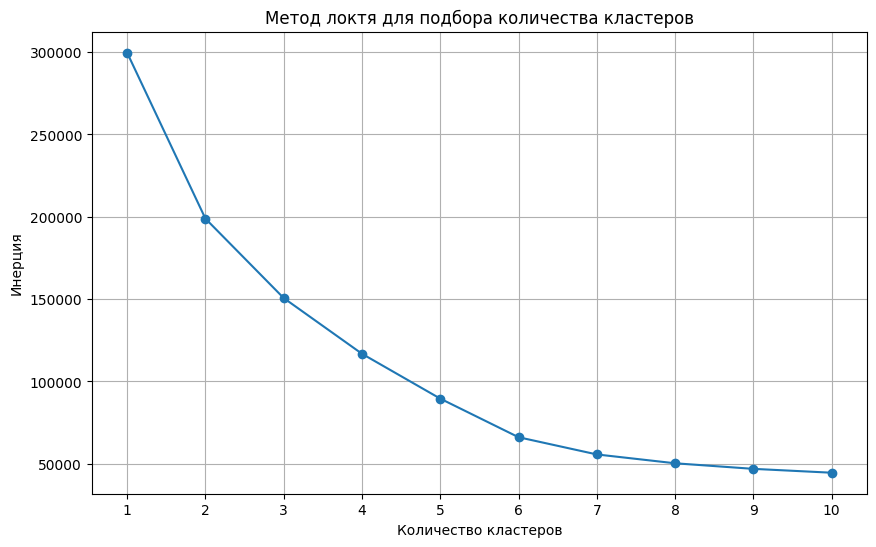

In [60]:
max_clusters = 10 
inertia = []  

for n_clusters in range(1, max_clusters + 1):
    kmeans = KMeans(n_clusters=n_clusters, 
                    init='k-means++', 
                    max_iter=300, 
                    n_init=10, 
                    random_state=RANDOM_STATE)
    
    kmeans.fit(X_scaled)  
    inertia.append(kmeans.inertia_) 

plt.figure(figsize=(10, 6))
plt.plot(range(1, max_clusters + 1), inertia, marker='o')
plt.title('Метод локтя для подбора количества кластеров')
plt.xlabel('Количество кластеров')
plt.ylabel('Инерция')
plt.xticks(range(1, max_clusters + 1))
plt.grid()
plt.show()

Точно определить наилучший вариант проблематично. Воспользуемся методом силуэтов:

In [61]:
range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10]

for num_clusters in range_n_clusters:

    # Инициализация kmeans
    kmeans = KMeans(n_clusters=num_clusters, max_iter=50, random_state=101)
    kmeans.fit(X_scaled)

    cluster_labels = kmeans.labels_

    # Вычисление коэффициента силуэта
    silhouette_avg = silhouette_score(X_scaled, cluster_labels)
    print("For n_clusters={0}, the silhouette score is {1}".format(num_clusters, silhouette_avg))

For n_clusters=2, the silhouette score is 0.350203243404417
For n_clusters=3, the silhouette score is 0.3628260605487623
For n_clusters=4, the silhouette score is 0.37263088155177426
For n_clusters=5, the silhouette score is 0.4208678688529576
For n_clusters=6, the silhouette score is 0.4730272553666204
For n_clusters=7, the silhouette score is 0.4949969464352972
For n_clusters=8, the silhouette score is 0.5021944246653832
For n_clusters=9, the silhouette score is 0.48241549451332466
For n_clusters=10, the silhouette score is 0.39924170843203044


Интересное наблюдение: метод силуэтов говорит о том, что наилучшее число кластеров - 8. При этом, нам заранее известно, что видов бобов всего 7. Для обучения модели кластеризации воспользуемся именно этим значением.

In [62]:
kmeans = KMeans(n_clusters=7, 
                    init='k-means++', 
                    max_iter=300, 
                    n_init=10, 
                    random_state=RANDOM_STATE)

kmeans.fit(X_scaled)

# Предсказание меток кластеров
y_kmeans = kmeans.fit_predict(X_scaled)

# Обратное преобразование данных для визуализации
X_transformed = scaler.inverse_transform(X_scaled)

In [63]:
data_for_show = pd.DataFrame(X_transformed, columns=X_encoded.columns)

data_for_show.head(1)

,area,perimeter,major_axis_length,minor_axis_length,aspect_ration,eccentricity,convex_area,equiv_diameter,extent,solidity,roundness,compactness,shape_factor1,shape_factor2,shape_factor3,shape_factor4,class_BOMBAY,class_CALI,class_DERMASON,class_HOROZ,class_SEKER,class_SIRA
0,28395.000,610.291,208.178,173.889,1.197,0.550,28715.000,190.141,0.764,0.989,0.958,0.913,0.007,0.003,0.834,0.999,0.000,0.000,0.000,0.000,1.000,0.000


In [64]:
data_for_show.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13611 entries, 0 to 13610
Data columns (total 22 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   area               13611 non-null  float64
 1   perimeter          13611 non-null  float64
 2   major_axis_length  13611 non-null  float64
 3   minor_axis_length  13611 non-null  float64
 4   aspect_ration      13611 non-null  float64
 5   eccentricity       13611 non-null  float64
 6   convex_area        13611 non-null  float64
 7   equiv_diameter     13611 non-null  float64
 8   extent             13611 non-null  float64
 9   solidity           13611 non-null  float64
 10  roundness          13611 non-null  float64
 11  compactness        13611 non-null  float64
 12  shape_factor1      13611 non-null  float64
 13  shape_factor2      13611 non-null  float64
 14  shape_factor3      13611 non-null  float64
 15  shape_factor4      13611 non-null  float64
 16  class_BOMBAY       136

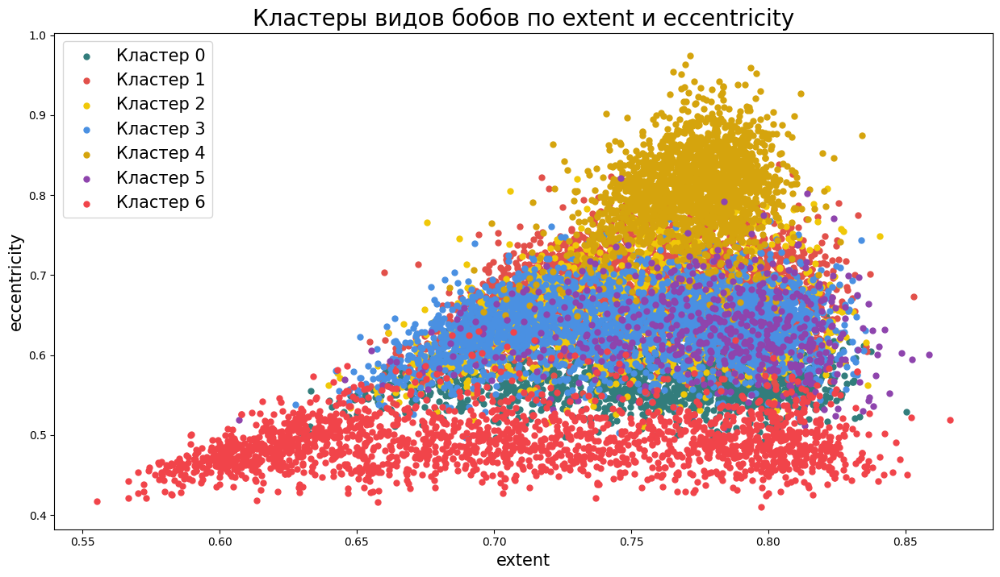

In [65]:
plt.figure(figsize=(15, 8))

colors = ["#327D7C", "#E2504A", "#F0C808", "#4A90E2", "#D5A40D", "#8E44AD", "#F1444A"]

for i in range(7): 
    plt.scatter(X_transformed[y_kmeans == i, X_encoded.columns.get_loc('extent')],
                X_transformed[y_kmeans == i, X_encoded.columns.get_loc('shape_factor3')],
                s=25, c=colors[i], label=f'Кластер {i}')

plt.title('Кластеры видов бобов по extent и eccentricity', fontsize=20)
plt.xlabel('extent', fontsize=15)
plt.ylabel('eccentricity', fontsize=15)

plt.legend(fontsize=15)

plt.show()

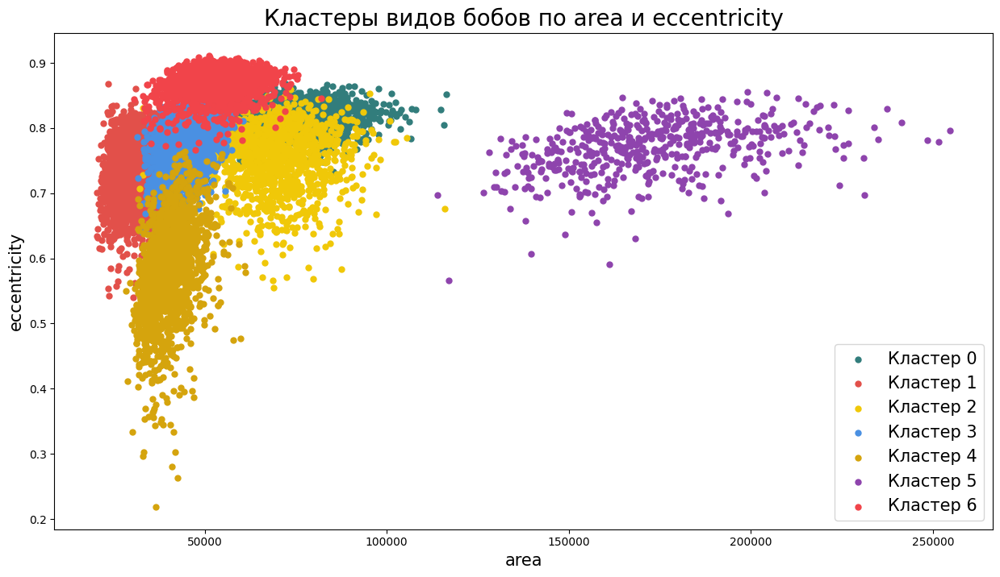

In [66]:
plt.figure(figsize=(15, 8))

colors = ["#327D7C", "#E2504A", "#F0C808", "#4A90E2", "#D5A40D", "#8E44AD", "#F1444A"]

for i in range(7): 
    plt.scatter(X_transformed[y_kmeans == i, X_encoded.columns.get_loc('area')],
                X_transformed[y_kmeans == i, X_encoded.columns.get_loc('eccentricity')],
                s=25, c=colors[i], label=f'Кластер {i}')

plt.title('Кластеры видов бобов по area и eccentricity', fontsize=20)
plt.xlabel('area', fontsize=15)
plt.ylabel('eccentricity', fontsize=15)

plt.legend(fontsize=15)

plt.show()

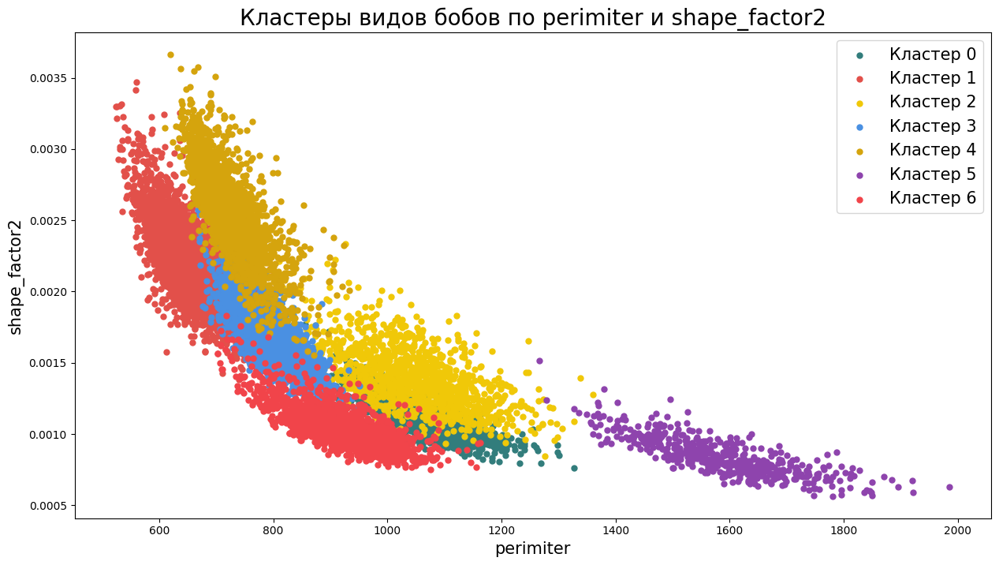

In [67]:
plt.figure(figsize=(15, 8))

colors = ["#327D7C", "#E2504A", "#F0C808", "#4A90E2", "#D5A40D", "#8E44AD", "#F1444A"]

for i in range(7): 
    plt.scatter(X_transformed[y_kmeans == i, X_encoded.columns.get_loc('perimeter')],
                X_transformed[y_kmeans == i, X_encoded.columns.get_loc('shape_factor2')],
                s=25, c=colors[i], label=f'Кластер {i}')

plt.title('Кластеры видов бобов по perimiter и shape_factor2', fontsize=20)
plt.xlabel('perimiter', fontsize=15)
plt.ylabel('shape_factor2', fontsize=15)

plt.legend(fontsize=15)

plt.show()

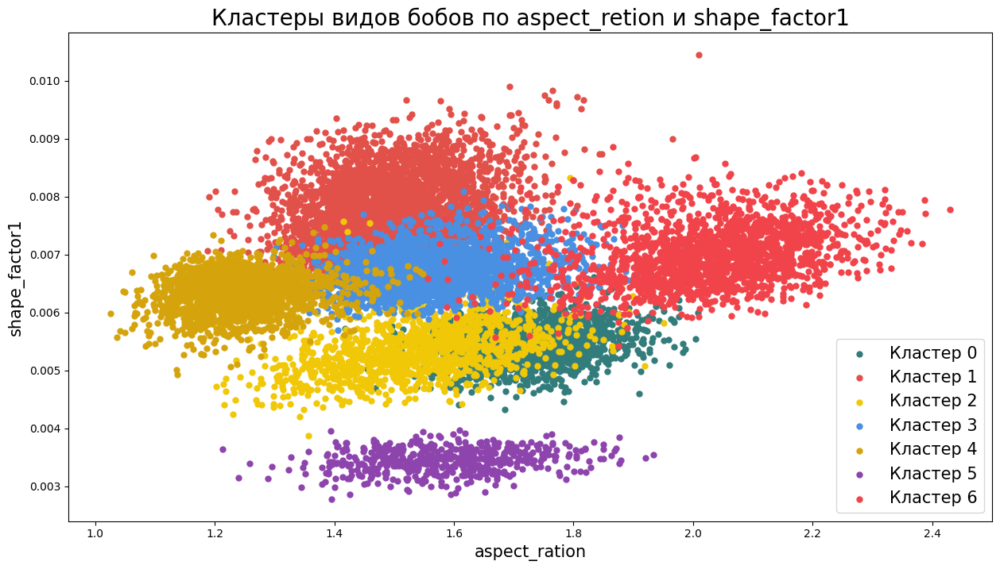

In [68]:
plt.figure(figsize=(15, 8))

colors = ["#327D7C", "#E2504A", "#F0C808", "#4A90E2", "#D5A40D", "#8E44AD", "#F1444A"]

for i in range(7): 
    plt.scatter(X_transformed[y_kmeans == i, X_encoded.columns.get_loc('aspect_ration')],
                X_transformed[y_kmeans == i, X_encoded.columns.get_loc('shape_factor1')],
                s=25, c=colors[i], label=f'Кластер {i}')

plt.title('Кластеры видов бобов по aspect_retion и shape_factor1', fontsize=20)
plt.xlabel('aspect_ration', fontsize=15)
plt.ylabel('shape_factor1', fontsize=15)

plt.legend(fontsize=15)

plt.show()

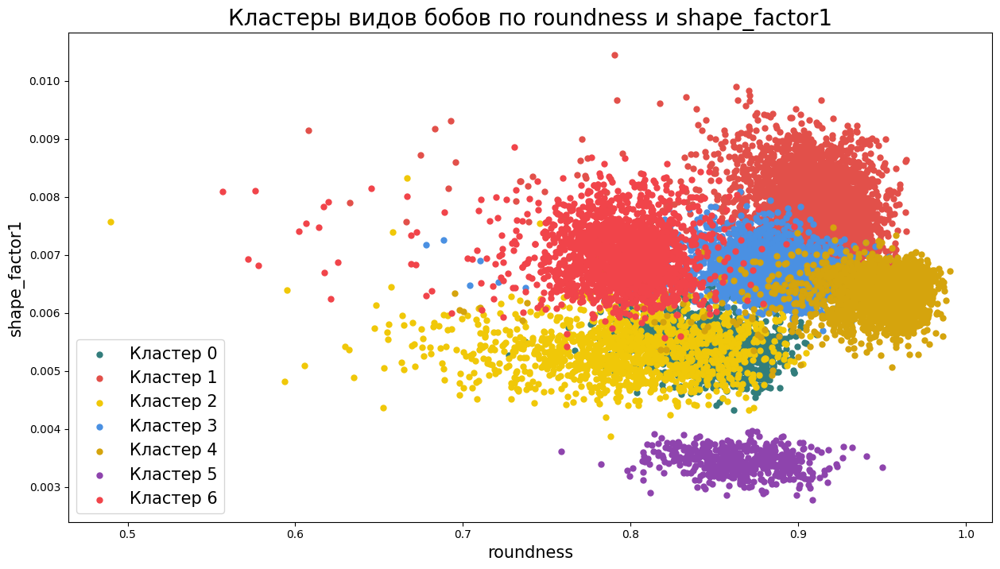

In [69]:
plt.figure(figsize=(15, 8))

colors = ["#327D7C", "#E2504A", "#F0C808", "#4A90E2", "#D5A40D", "#8E44AD", "#F1444A"]

for i in range(7): 
    plt.scatter(X_transformed[y_kmeans == i, X_encoded.columns.get_loc('roundness')],
                X_transformed[y_kmeans == i, X_encoded.columns.get_loc('shape_factor1')],
                s=25, c=colors[i], label=f'Кластер {i}')

plt.title('Кластеры видов бобов по roundness и shape_factor1', fontsize=20)
plt.xlabel('roundness', fontsize=15)
plt.ylabel('shape_factor1', fontsize=15)

plt.legend(fontsize=15)

plt.show()

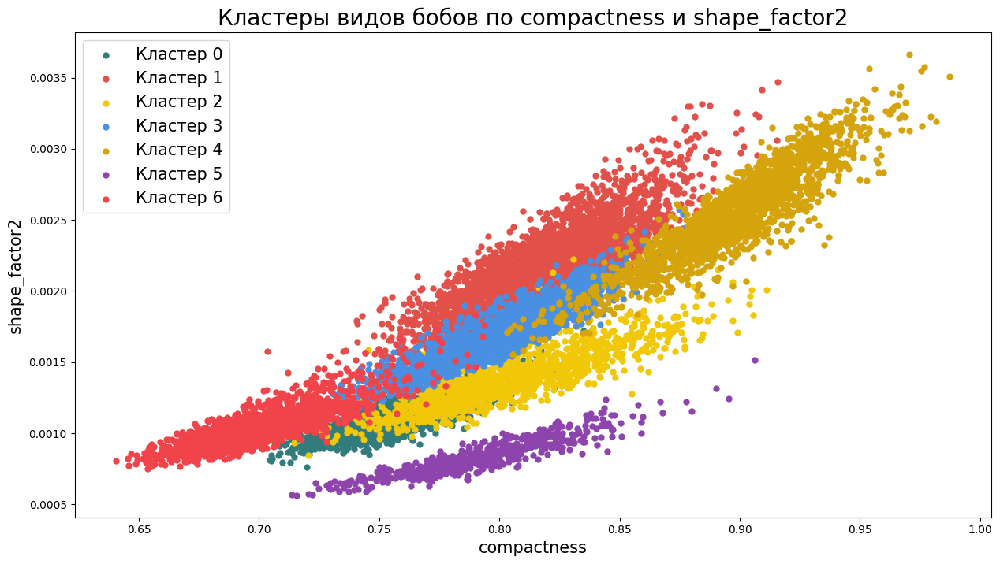

In [70]:
plt.figure(figsize=(15, 8))

colors = ["#327D7C", "#E2504A", "#F0C808", "#4A90E2", "#D5A40D", "#8E44AD", "#F1444A"]

for i in range(7): 
    plt.scatter(X_transformed[y_kmeans == i, X_encoded.columns.get_loc('compactness')],
                X_transformed[y_kmeans == i, X_encoded.columns.get_loc('shape_factor2')],
                s=25, c=colors[i], label=f'Кластер {i}')

plt.title('Кластеры видов бобов по compactness и shape_factor2', fontsize=20)
plt.xlabel('compactness', fontsize=15)
plt.ylabel('shape_factor2', fontsize=15)

plt.legend(fontsize=15)

plt.show()

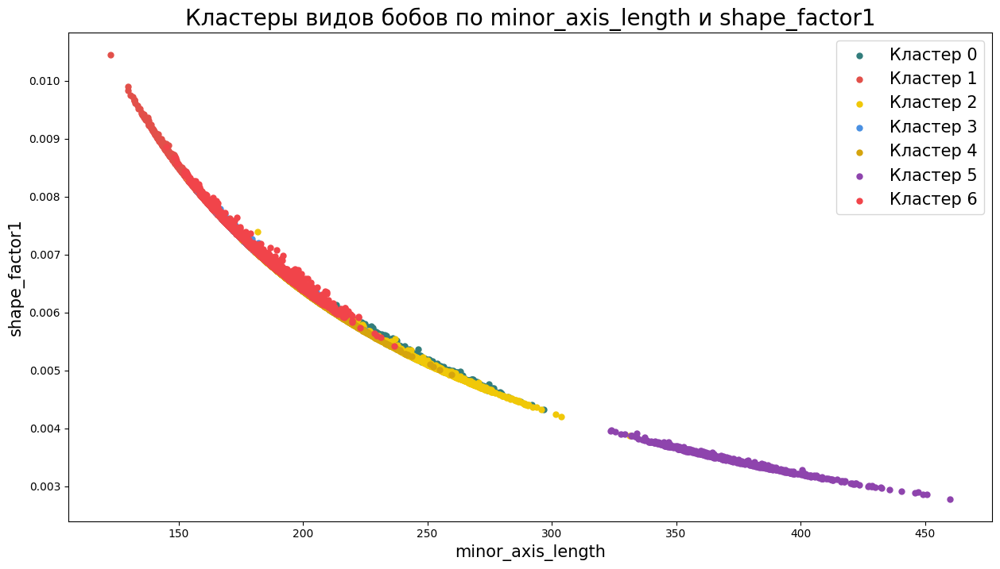

In [71]:
plt.figure(figsize=(15, 8))

colors = ["#327D7C", "#E2504A", "#F0C808", "#4A90E2", "#D5A40D", "#8E44AD", "#F1444A"]

for i in range(7): 
    plt.scatter(X_transformed[y_kmeans == i, X_encoded.columns.get_loc('minor_axis_length')],
                X_transformed[y_kmeans == i, X_encoded.columns.get_loc('shape_factor1')],
                s=25, c=colors[i], label=f'Кластер {i}')

plt.title('Кластеры видов бобов по minor_axis_length и shape_factor1', fontsize=20)
plt.xlabel('minor_axis_length', fontsize=15)
plt.ylabel('shape_factor1', fontsize=15)

plt.legend(fontsize=15)

plt.show()

## 6 Итог

В лаборатной работе было проведено исследование датасета Dry_Beans, найденного на просторах Kaggle. Проведен исследовательский и корреляционный анализ. Также в ходе выполнения проекта данные были предобработаны и подготовлены.

Обучена модель кластеризации KMeans, предсказаны метки кластеров для соотвествующих видов бобов. Проведена визуализация на основе предсказанных меток, затрагивающая зависимости различных признаков. 